# TUGAS ALJABAR LINEAR | PENERAPAN SVD - IMAGE COMPRESSION

Disusun oleh : Zaidan Harith (23/512629/TK/56334)
___

## Landasan Teori

### A. Definisi Singular Value Decomposition (SVD)

Singular Value Decomposition (SVD) adalah metode aljabar linear yang memecah suatu matriks $A$ yang berukuran $m \times n$ menjadi tiga komponen :

- **Matriks $U$** : Matriks ortogonal yang berisi _eigenvector_ kiri dari $A^TA$ yang berukuran $m \times m$.
- **Matriks $\Sigma$** : Matriks diagonal berukuran $m \times n$ yang berisi nilai singular dari $A^TA$ diurutkan dari yang terbesar.
- **Matriks $V$** : Matriks ortogonal yang berisi _eigenvector_ kanan dari $AA^T$ yang berukuran $n \times n$.

SVD memiliki beberapa karakteristik yang membuatnya bermanfaat untuk melakukan kompresi pada gambar, seperti :

- **Dekomposisi kompak** : SVD dapat merepresentasikan matriks dengan jumlah kolom lebih sedikit dengan hanya menyimpan nilai singular yang signifikan.

- **Sifat ortogonal** : Matriks $U$ dan $V$ adalah ortogonal sehingga dapat memudahkan melakukan rekonstruksi pada gambar.

- **Ketahanan terhadap _noise_** : Nilai singular yang kecil biasanya mewakili _noise_ dalam gambar dan dapat diabaikan untuk kompresi _lossy_.

### B. Langkah-langkah Kompresi Gambar Menggunakan SVD

1. **Membaca gambar** : Baca gambar digital dan representasikan sebagai matriks.

2. **Melakukan SVD** : Lakukan dekomposisi SVD pada matriks gambar.

3. **Memilih nilai singular** : Pilih nilai singular yang akan disimpan berdasarkan tingkat kompresi yang diinginkan. Nilai singular yang lebih kecil, yang mewakili informasi yang kurang penting, dapat diabaikan untuk mencapai kompresi lebih tinggi.

4. **Membangun matriks terkompresi** : Buat matriks baru yang terkompresi dengan menggunakan kolom yang terkait dengan nilai singular yang dipilih.
Merekonstruksi gambar: Rekonstruksi gambar dari matriks terkompresi dengan mengalikan matriks $U$, $S$, dan $V^T$.

### C. Kelebihan Menggunakan SVD untuk Kompresi Gambar

- **Efisiensi** : SVD dapat mencapai tingkat kompresi yang tinggi sambil mempertahankan kualitas gambar yang baik.

- **Ketahanan terhadap _noise_** : SVD dapat membantu menghilangkan _noise_ dari gambar selama proses kompresi.

- **Kesederhanaan** : Algoritma SVD relatif mudah diimplementasikan.

### D. Kekurangan Menggunakan SVD untuk Kompresi Gambar

- **Kehilangan data** : Kompresi _lossy_ dengan SVD akan menghilangkan sebagian informasi dari gambar asli.

- **Kompleksitas komputasi** : Perhitungan SVD dapat memakan waktu lama untuk gambar beresolusi tinggi.

## Source Code Program Kompresi Gambar Menggunakan Python

### 1. Memanggil _Library_ yang dibutuhkan

In [31]:
from PIL import Image
import numpy as np
import os

### 2. Masukkan gambar yang ingin dikompresi

Gambar yang diunggah akan ditampung ke dalam variabel yang bernama `gambarAsli`.

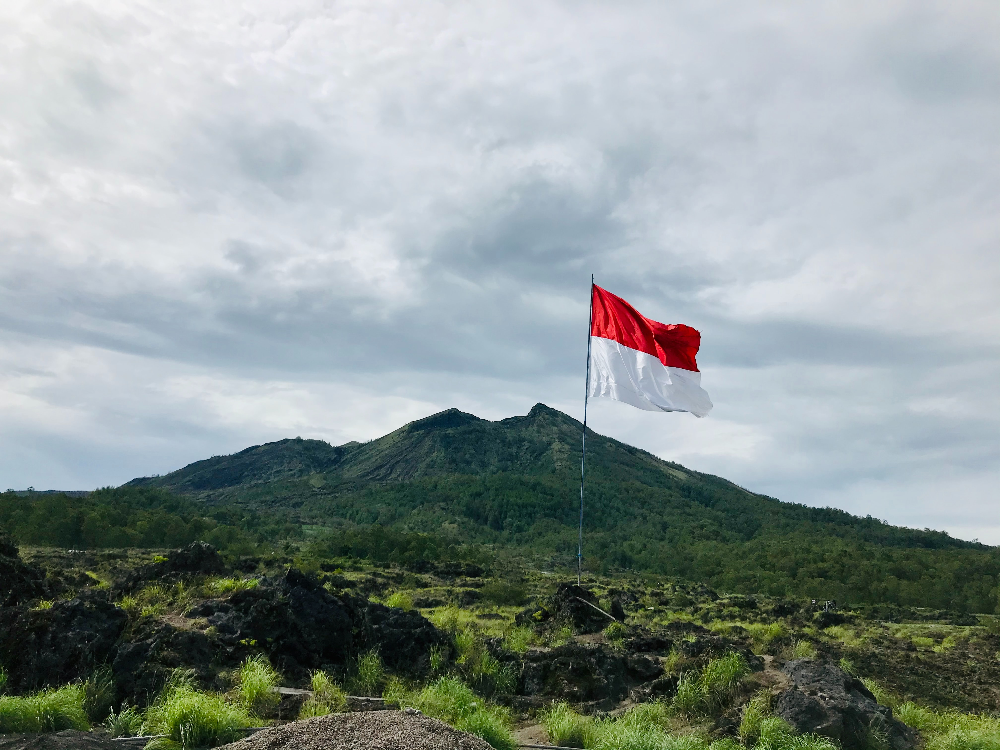

In [32]:
gambarAsli = Image.open('gambar.jpg')
gambarAsli

### 3. Ubah gambar menjadi _grayscale_ (Hitam Putih)

Gambar pada variabel `gambarAsli` diubah menjadi gambar _grayscale_ dengan menggunakan _method_ `.convert('L')` dan tampung hasil gambar yang baru ke dalam variabel `gambarGrayscale`. Gambar baru tesebut juga disimpan ke dalam file gambar baru bernama `gambar-grayscale.jpg`.

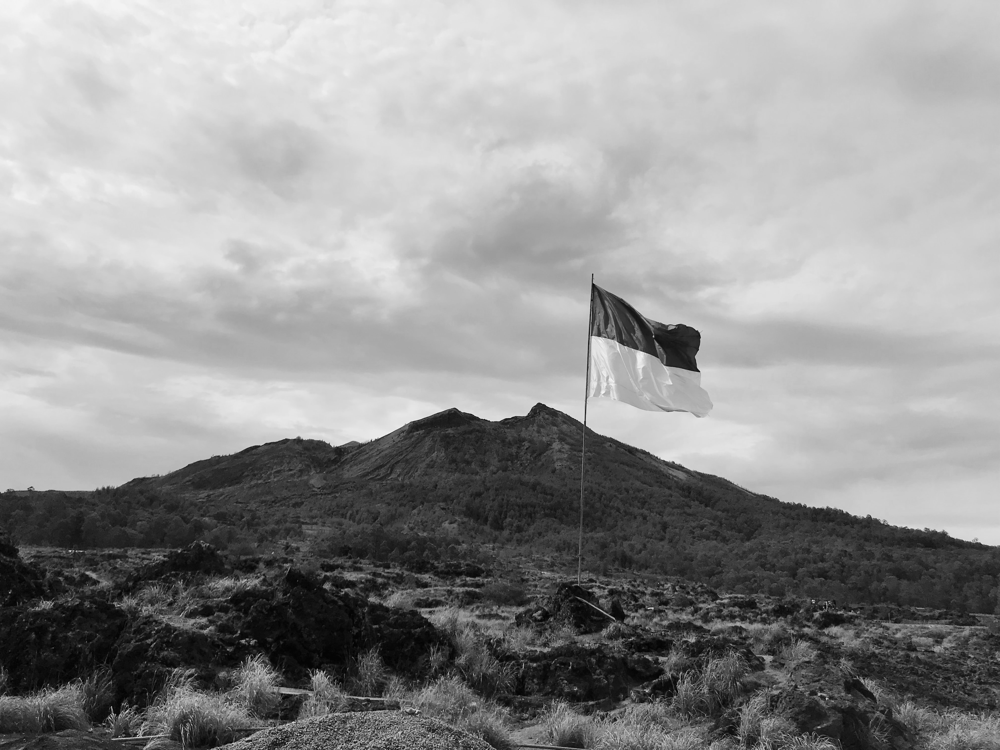

In [33]:
gambarGrayscale = gambarAsli.convert('L')
gambarGrayscale.save("gambar-grayscale.jpg")
gambarGrayscale

### 4. Cetak ukuran gambar asli dan _grayscale_

Untuk mendapatkan ukuran gambar, dapat kita gunakan _method_ dari _library_ `os` yang bernama `os.path.getsize()`.

In [34]:
ukuranGambarAsli = os.path.getsize('gambar.jpg')
ukuranGambarGrayscale = os.path.getsize('gambar-grayscale.jpg')

print("Ukuran gambar asli : ", ukuranGambarAsli, " bytes")
print("Ukuran gambar grayscale : ", ukuranGambarGrayscale, " bytes")

Ukuran gambar asli :  1328724  bytes
Ukuran gambar grayscale :  975655  bytes


### 5. Konversi gambar _grayscale_ menjadi sebuah matriks

Konversi gambar menjadi matriks dapat dilakukan dengan memanfaatkan _library_ `numpy` yang telah didefinisikan sebagai `np`.

In [35]:
matriksGambarGrayscale = np.array(gambarGrayscale)
matriksGambarGrayscale

array([[244, 244, 244, ..., 204, 205, 205],
       [244, 244, 244, ..., 205, 205, 206],
       [244, 244, 244, ..., 205, 206, 206],
       ...,
       [ 51,  48,  50, ..., 102,  88,  86],
       [ 52,  51,  53, ...,  90,  77,  75],
       [ 44,  48,  52, ...,  90,  78,  76]], dtype=uint8)

### 6. Memecah matriks gambar menjadi tiga komponen utama SVD, yaitu matriks $U$, $\Sigma$, dan $V^T$

In [36]:
matriksU, matriksSigma, matriksVTranspose = np.linalg.svd(matriksGambarGrayscale, full_matrices=False)

print(matriksU.shape, matriksSigma.shape, matriksVTranspose.shape)

print("Matriks U = ", matriksU)
print("Matriks Σ = ", matriksSigma)
print("Matriks U = ", matriksVTranspose)

(3024, 3024) (3024,) (3024, 4032)
Matriks U =  [[ 0.02492689  0.01145143  0.00201683 ... -0.03733191 -0.0092597
  -0.01398791]
 [ 0.02492861  0.0114707   0.00200834 ...  0.07923167  0.02293983
   0.0242973 ]
 [ 0.02492941  0.01146953  0.00198544 ... -0.08677541 -0.02387985
   0.02819274]
 ...
 [ 0.00903101  0.00967115 -0.00396174 ...  0.0015491  -0.00032704
   0.00180765]
 [ 0.00912392  0.01001962 -0.00442455 ... -0.00071385 -0.00066989
  -0.00172993]
 [ 0.00915083  0.01016479 -0.00447108 ...  0.00011321  0.00049129
   0.0007612 ]]
Matriks Σ =  [5.65825357e+05 6.54295265e+04 4.31132175e+04 ... 2.05876763e+00
 2.03852220e+00 2.01814781e+00]
Matriks U =  [[ 0.01677675  0.01677777  0.01678392 ...  0.01624142  0.01626816
   0.01629472]
 [-0.00591423 -0.00595909 -0.00597862 ... -0.02576617 -0.02588788
  -0.02591119]
 [ 0.01479041  0.01496915  0.01504217 ... -0.02537521 -0.02539161
  -0.02549083]
 ...
 [ 0.00089151  0.00056367  0.00620707 ...  0.00336697  0.00171834
   0.00037795]
 [-0.00858

### 7. Lakukan kompresi pada gambar _grayscale_ dengan cara memangkas matriks gambar dengan mengalikan dengan suatu nilai $k$

Gambar dapat dikompresi dengan cara mengalikannya dengan suatu nilai $k$ yang merepresentasikan tingkat kompresi gambar. Semakin kecil nilai $k$, maka gambar akan semakin kecil ukurannya dan semakin buram. Nilai $k$ sendiri berada di rentang $0 \leq k \leq 255$.

In [37]:
k = 50
matriksU_k = matriksU[:, :k]
matriksSigma_k = matriksSigma[:k]
matriksVTranspose_k = matriksVTranspose[:k, :]

print(matriksU_k.shape, matriksSigma_k.shape, matriksVTranspose_k.shape)

(3024, 50) (50,) (50, 4032)


### 8. Bentuk matriks baru yang berupa matriks gambar hasil kompresi

Matriks gambar yang dibuat ditampung ke dalam variabel `matriksGambarTerkompresi`. Namun, sebelumnya, matriks $\Sigma$ harus didiagonalisasi terlebih dahulu.

In [38]:
matriksSigma_k = np.diag(matriksSigma_k)

matriksGambarTerkompresi = np.dot(np.dot(matriksU_k, matriksSigma_k), matriksVTranspose_k)
matriksGambarTerkompresi

array([[239.03036878, 239.23425673, 239.76902419, ..., 202.79849183,
        202.67786637, 202.91267028],
       [239.01111874, 239.21431734, 239.74585865, ..., 202.90648986,
        202.78749174, 203.01832732],
       [238.89102368, 239.09650234, 239.63394554, ..., 203.04596093,
        202.92684906, 203.15741378],
       ...,
       [ 59.60692457,  57.85747741,  59.96992177, ...,  86.33861146,
         81.07973679,  80.54800284],
       [ 64.90914409,  63.39413987,  65.83592041, ...,  94.84430693,
         91.66333317,  92.19355855],
       [ 65.38365658,  63.9383638 ,  65.97311101, ..., 100.10733015,
         97.86191421,  98.80468786]])

### 9. Konversi kembali matriks gambar yang baru menjadi sebuah gambar RGB

Untuk melakukan konversi matriks gambar menjadi gambar RGB, dapat kita gunakan _method_ dari _library_ `numpy` yang sudah didefinisikan sebagai `np` yang bernama `.clip()`, `.astype()`, dan `.fromarray()`.

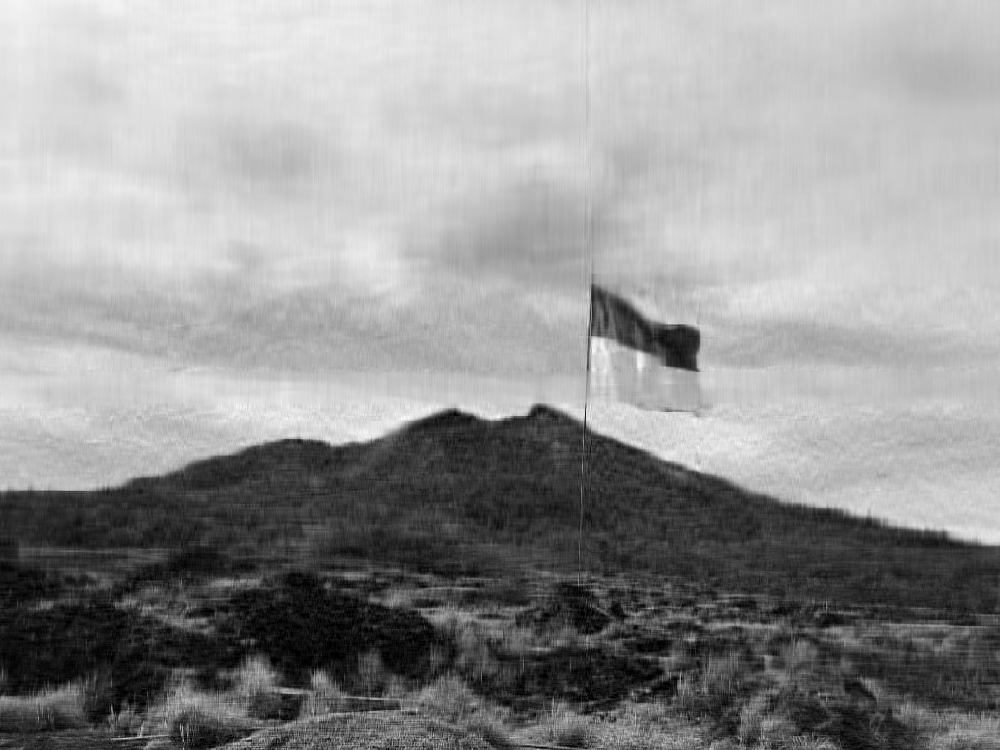

In [39]:
matriksGambarTerkompresi = np.clip(matriksGambarTerkompresi, 0, 255)

matriksGambarTerkompresi = matriksGambarTerkompresi.astype(np.uint8)

gambarTerkompresi = Image.fromarray(matriksGambarTerkompresi)
gambarTerkompresi

### 10. Simpan gambar RGB dan cetak ukuran gambar

Gambar yang sudah dikompresi dapat disimpan dengan menggunakan _method_ `.save()`. Cetak ukuran file gambar asli, gambar _grayscale_ dan gambar terkompresi sebagai perbandingan ukuran file sebelum dan sesudah dilakukan kompresi.

In [40]:
gambarTerkompresi.save('gambar-terkompresi.jpg')

print("Ukuran gambar asli :", os.path.getsize('gambar.jpg'), "bytes")
print('Ukuran gambar grayscale :', os.path.getsize('gambar-grayscale.jpg'), "bytes")
print('Ukuran gambar terkompresi :', os.path.getsize('gambar-terkompresi.jpg'), "bytes")

Ukuran gambar asli : 1328724 bytes
Ukuran gambar grayscale : 975655 bytes
Ukuran gambar terkompresi : 692220 bytes
